# <img src="./data/energy-dynamic.png" alt="Statistics Icon" width="30"/> **Final Data Science Project : Fault and Malfunction Detection ML Modelling for Onshore Wind Turbine** <img src="./data/books.png" alt="Book Icon" width="30"/>

Our focus is on the wind turbine at Kelmarsh in the UK wind farm. Through the utilization of *<span style="color:#4285f4">data science techniques and SCADA data</span>*, we aim to improve *<span style="color:#4285f4">fault and malfunction detection</span>*, ensuring enhanced operational *<span style="color:#4285f4">reliability</span>*.

# <img src="./data/target.png" alt="Objective Icon" width="30"/> **Objective**

By delving into the dataset, our aim is not only to facilitate *<span style="color:#4285f4">informed decision-making for turbine maintenance teams</span>* but also to deepen our understanding of the *<span style="color:#4285f4">diverse factors</span>* influencing turbine *<span style="color:#4285f4">performance and reliability</span>*. 

Through comprehensive analysis of SCADA data, we aim to achieve the following:

- Identify and classify various fault and malfunction patterns
- Develop a robust machine learning model for early detection and diagnosis of turbine issues
- Optimize turbine performance to ensure maximum energy output
- Enhance operational reliability and minimize downtime


# <img src="./data/file.png" alt="Overview Icon" width="30"/> **Dataset Overview and Data Attribution**

For this project, only *<span style="color:#4285f4">one turbine was selected</span>*, adhering to the standard practice of testing models on a single turbine before scaling up. To ensure *<span style="color:#4285f4">balanced data</span>*, the selection process prioritized identifying the turbine with the *<span style="color:#4285f4">highest frequency of faults and malfunctions</span>*. Subsequently, the data was grouped by year from *<span style="color:#4285f4">2021 to the end of 2022</span>*. 

It contains 2 data:
- 10-minute SCADA data providing *<span style="color:#4285f4">technical measurements</span>*
- Minutely *<span style="color:#4285f4">status/events</span>* data

The dataset has been released by [Cubico Sustainable Investments Ltd](https://www.cubicoinvest.com/) under a [CC-BY-4.0](https://creativecommons.org/licenses/by/4.0/legalcode) open data license. 


# <img src="./data/iteration.png" alt="Methodology Icon" width="30"/> **Methodology**

![Methodology](./data/methodology12.png)

# <img src="./data/question-mark.png" alt="Questionmark Icon" width="30"/> **Question for Deeper Insights**

1. **What are the *<span style="color:#4285f4">main fault and malfunction patterns</span>* observed in the turbine's operational data?**

2. **How do these patterns relate to changes in *<span style="color:#4285f4">wind speed, rotor speed</span>*, and other *<span style="color:#4285f4">operational parameters</span>*?** 

3. **Can we detect *<span style="color:#4285f4">recurring patterns or anomalies</span>* in the turbine's performance data that suggest underlying issues?**

4. **What is the best and most efficient way to *<span style="color:#4285f4">predict and anticipate</span>* these anomalies moving forward?**

In [2]:
# essential libraries for this EDA
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import category_encoders as ce
from category_encoders import BinaryEncoder
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix, f1_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import Adam

# <img src="./data/data-cleaning.png" alt="Datacleaning Icon" width="30"/> **Data Exploration**

In [3]:
# read & load the dataset into pandas dataframe
status_2021 = pd.read_csv('./data/Status_Kelmarsh_3_2021.csv', delimiter=',')
status_2022 = pd.read_csv('./data/Status_Kelmarsh_3_2022.csv', delimiter=',')
data_2021 = pd.read_csv('./data/Turbine_Data_Kelmarsh_3_2021.csv', delimiter=',', skiprows=9)
data_2022 = pd.read_csv('./data/Turbine_Data_Kelmarsh_3_2022.csv', delimiter=',', skiprows=9)

In [4]:
# Renaming the first column of the dataframe for the year 2021 to 'Date and time'
data_2021.rename(columns={data_2021.columns[0]: 'Date and time'}, inplace=True)

# Renaming the first column of the dataframe for the year 2022 to 'Date and time'
data_2022.rename(columns={data_2022.columns[0]: 'Date and time'}, inplace=True)


## Data Cleaning for Status Data 2021

In [5]:
# Replace '-' values in the 'Duration' column with NaN (missing value)
status_2021['Duration'] = status_2021['Duration'].replace('-', np.nan)

# Replace '-' values in the 'Timestamp end' column with NaN (missing value)
status_2021['Timestamp end'] = status_2021['Timestamp end'].replace('-', np.nan)

# Convert the 'Timestamp start' column to datetime format
status_2021['Timestamp start'] = pd.to_datetime(status_2021['Timestamp start'])

In [6]:
# Iterate over rows of the DataFrame
for idx, row in status_2021.iterrows():
    # Check if the 'Timestamp end' value in the current row is NaN and 
    # if the current index + 1 is within the DataFrame's length
    if pd.isna(row['Timestamp end']) and idx + 1 < len(status_2021):
        # Replace the '-' value in the 'Timestamp end' column with the 'Timestamp start' value from the next row
        status_2021.at[idx, 'Timestamp end'] = status_2021.at[idx + 1, 'Timestamp start']

In [7]:
# Compute the number of missing values (NaN) in each column of the DataFrame status_2021
status_2021.isna().sum()

Timestamp start                  0
Timestamp end                    1
Duration                     10346
Status                           0
Code                             0
Message                          0
Comment                      12262
Service contract category     9754
IEC category                    67
Global contract category     12143
Custom contract category     12262
dtype: int64

In [8]:
# Find rows with missing values in 'Timestamp end' column
missing_timestamp_end = status_2021['Timestamp end'].isna()

# Get the index of rows with missing values in 'Timestamp end'
rows_with_missing_end = status_2021[missing_timestamp_end].index

print("Rows with missing values in 'Timestamp end':", rows_with_missing_end)

Rows with missing values in 'Timestamp end': Index([12261], dtype='int64')


In [9]:
# Sanity check
status_2021.iloc[12260:12262]

,Timestamp start,Timestamp end,Duration,Status,Code,Message,Comment,Service contract category,IEC category,Global contract category,Custom contract category
12260,2021-12-30 22:58:01,2021-12-30 22:58:11,00:00:10,Warning,6052,High yaw motor current,NaN,Warnings (27),Full Performance,NaN,NaN
12261,2021-12-30 22:58:11,NaN,NaN,Informational,0,System OK,NaN,System OK (32),Full Performance,NaN,NaN


In [10]:
# Set the value in the 'Timestamp end' column at row index 12261 to be equal to 
# the value in the 'Timestamp start' column at the same row index
status_2021.at[12261, 'Timestamp end'] = status_2021.at[12261, 'Timestamp start']

In [11]:
# Sanity check
status_2021.tail()

,Timestamp start,Timestamp end,Duration,Status,Code,Message,Comment,Service contract category,IEC category,Global contract category,Custom contract category
12257,2021-12-28 23:38:41,2021-12-28 23:38:51,NaN,Informational,100190,Mains connection,NaN,NaN,Full Performance,NaN,NaN
12258,2021-12-28 23:38:51,2021-12-28 23:39:21,NaN,Informational,100200,Mains run-up,NaN,NaN,Full Performance,NaN,NaN
12259,2021-12-28 23:39:21,2021-12-30 22:58:01,NaN,Informational,100210,Mains operation,NaN,NaN,Full Performance,NaN,NaN
12260,2021-12-30 22:58:01,2021-12-30 22:58:11,00:00:10,Warning,6052,High yaw motor current,NaN,Warnings (27),Full Performance,NaN,NaN
12261,2021-12-30 22:58:11,2021-12-30 22:58:11,NaN,Informational,0,System OK,NaN,System OK (32),Full Performance,NaN,NaN


## Data Cleaning for Status Data 2022

In [12]:
# Compute the number of missing values (NaN) in each column of the DataFrame status_2022
status_2022.isna().sum()

Timestamp start                  0
Timestamp end                    2
Duration                         2
Status                           2
Code                             2
Message                          2
Comment                      13701
Service contract category    10188
IEC category                    49
Global contract category     13594
Custom contract category     13714
dtype: int64

In [13]:
# Locate rows where 'Timestamp end' is NaT
status_2022.loc[status_2022['Timestamp end'].isna()]

,Timestamp start,Timestamp end,Duration,Status,Code,Message,Comment,Service contract category,IEC category,Global contract category,Custom contract category
12428,"2022-11-01 07:47:36,2022-11-01 09:40:17,01:52:...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12480,"2022-11-01 14:28:00,2022-11-01 16:13:21,01:45:...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [14]:
# Define the rows where the issue occurs
problematic_rows = [12428, 12480]

# Loop through each problematic row
for row_index in problematic_rows:
    # Convert 'Timestamp start' value to string
    timestamp_str = str(status_2022.at[row_index, 'Timestamp start'])
    
    # Split the string into separate components
    split_values = timestamp_str.split(',')
    
    # Iterate over split values and assign them to the appropriate columns
    for i, value in enumerate(split_values):
        # Handle special cases where there might be fewer columns
        if i >= len(status_2022.columns):
            break
        # Assign the value to the corresponding column
        status_2022.at[row_index, status_2022.columns[i]] = value.strip() if value.strip() != "-" else np.nan

In [15]:
# Sanity Check
status_2022.loc[status_2022['Timestamp end'].isna()]

,Timestamp start,Timestamp end,Duration,Status,Code,Message,Comment,Service contract category,IEC category,Global contract category,Custom contract category


In [16]:
# Sanity Check
status_2022.iloc[[12428, 12480, 12481]]

,Timestamp start,Timestamp end,Duration,Status,Code,Message,Comment,Service contract category,IEC category,Global contract category,Custom contract category
12428,2022-11-01 07:47:36,2022-11-01 09:40:17,01:52:41,Stop,20,Manual stop - on site,"""Annual stats and basement ladders """,Manual stop (service) (9),Scheduled Maintenance,06 (Int) Scheduled Maintenance,
12480,2022-11-01 14:28:00,2022-11-01 16:13:21,01:45:21,Stop,25,Manual stop without login,"""Annual stats and basement ladders """,Manual stop (service) (9),Scheduled Maintenance,06 (Int) Scheduled Maintenance,
12481,2022-11-01 14:28:00,-,-,Informational,100050.0,Brake program 60,NaN,NaN,Technical Standby,NaN,NaN


In [17]:
# Replace '-' values in the 'Duration' column with NaN (missing value)
status_2022['Duration'] = status_2022['Duration'].replace('-', np.nan)

# Replace '-' values in the 'Timestamp end' column with NaN (missing value)
status_2022['Timestamp end'] = status_2022['Timestamp end'].replace('-', np.nan)

# Convert the 'Timestamp start' column to datetime format
status_2022['Timestamp start'] = pd.to_datetime(status_2022['Timestamp start'])

In [18]:
# Iterate over rows of the DataFrame
for idx, row in status_2022.iterrows():
    # Check if the 'Timestamp end' value in the current row is NaN and 
    # if the current index + 1 is within the DataFrame's length
    if pd.isna(row['Timestamp end']) and idx + 1 < len(status_2022):
        # Replace the '-' value in the 'Timestamp end' column with the 'Timestamp start' value from the next row
        status_2022.at[idx, 'Timestamp end'] = status_2022.at[idx + 1, 'Timestamp start']

In [19]:
# Find rows with missing values in 'Timestamp end' column
missing_timestamp_end2 = status_2022['Timestamp end'].isna()

# Get the index of rows with missing values in 'Timestamp end'
rows_with_missing_end2 = status_2022[missing_timestamp_end2].index

print("Rows with missing values in 'Timestamp end':", rows_with_missing_end2)

Rows with missing values in 'Timestamp end': Index([13713], dtype='int64')


In [20]:
# Sanity check
status_2022.iloc[13712:13714]

,Timestamp start,Timestamp end,Duration,Status,Code,Message,Comment,Service contract category,IEC category,Global contract category,Custom contract category
13712,2022-12-30 23:13:57,2022-12-30 23:14:27,NaN,Informational,100200.0,Mains run-up,NaN,NaN,Full Performance,NaN,NaN
13713,2022-12-30 23:14:27,NaN,NaN,Informational,100210.0,Mains operation,NaN,NaN,Full Performance,NaN,NaN


In [21]:
# Set the value in the 'Timestamp end' column at row index 13713 to be equal to
# the value in the 'Timestamp start' column at the same row index
status_2022.at[13713, 'Timestamp end'] = status_2022.at[13713, 'Timestamp start']


In [22]:
# Sanity Check
status_2022.tail()

,Timestamp start,Timestamp end,Duration,Status,Code,Message,Comment,Service contract category,IEC category,Global contract category,Custom contract category
13709,2022-12-30 23:11:31,2022-12-30 23:11:46,NaN,Informational,100160.0,System test 3,NaN,NaN,Technical Standby,NaN,NaN
13710,2022-12-30 23:11:46,2022-12-30 23:13:46,NaN,Informational,100180.0,Run-up,NaN,NaN,Technical Standby,NaN,NaN
13711,2022-12-30 23:13:46,2022-12-30 23:13:57,NaN,Informational,100190.0,Mains connection,NaN,NaN,Full Performance,NaN,NaN
13712,2022-12-30 23:13:57,2022-12-30 23:14:27,NaN,Informational,100200.0,Mains run-up,NaN,NaN,Full Performance,NaN,NaN
13713,2022-12-30 23:14:27,2022-12-30 23:14:27,NaN,Informational,100210.0,Mains operation,NaN,NaN,Full Performance,NaN,NaN


In [23]:
status_2022.isna().sum()

Timestamp start                  0
Timestamp end                    0
Duration                     11849
Status                           0
Code                             0
Message                          0
Comment                      13699
Service contract category    10186
IEC category                    47
Global contract category     13592
Custom contract category     13712
dtype: int64

## Data Merging for Status Data's

In [24]:
# Concatenate the DataFrames status_2021 and status_2022
status = pd.concat([status_2021, status_2022], axis=0)


In [25]:
# Check data information
status.info()

<class 'pandas.core.frame.DataFrame'>
Index: 25976 entries, 0 to 13713
Data columns (total 11 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Timestamp start            25976 non-null  datetime64[ns]
 1   Timestamp end              25976 non-null  object        
 2   Duration                   3781 non-null   object        
 3   Status                     25976 non-null  object        
 4   Code                       25976 non-null  object        
 5   Message                    25976 non-null  object        
 6   Comment                    15 non-null     object        
 7   Service contract category  6036 non-null   object        
 8   IEC category               25862 non-null  object        
 9   Global contract category   241 non-null    object        
 10  Custom contract category   2 non-null      object        
dtypes: datetime64[ns](1), object(10)
memory usage: 2.4+ MB


In [26]:
# Remove specified columns as they contain high amount of NaN values
status.drop(columns=['Global contract category','Custom contract category','Service contract category', 'Comment'], inplace=True)

In [27]:
# Filter rows in the DataFrame status where the 'Status' column equals "Stop", 
# then count the occurrences of each unique value in the 'Status' column
status_stop = status[status['Status'] == "Stop"]["Status"].value_counts()
status_stop


Status
Stop    235
Name: count, dtype: int64

In [28]:
# Sanity check
status.isna().sum()

Timestamp start        0
Timestamp end          0
Duration           22195
Status                 0
Code                   0
Message                0
IEC category         114
dtype: int64

## Data Cleaning for Turbine Data's

In [29]:
# Convert the 'Date and time' column to datetime format in the DataFrame data_2021
data_2021['Date and time'] = pd.to_datetime(data_2021['Date and time'])

# Convert the 'Date and time' column to datetime format in the DataFrame data_2022
data_2022['Date and time'] = pd.to_datetime(data_2022['Date and time'])


In [30]:
# Concatenate the DataFrames data_2021 and data_2022
data = pd.concat([data_2021, data_2022], axis=0)

In [31]:
# Check turbine data information
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 105120 entries, 0 to 52559
Columns: 303 entries, Date and time to Tower Acceleration Y, StdDev (mm/ss)
dtypes: datetime64[ns](1), float64(288), int64(14)
memory usage: 243.8 MB


In [32]:
# List of columns that contains data that might create bias for machine learning algoritms
columns_to_remove = [
    'Wind speed, Minimum (m/s)', 'Wind speed, Maximum (m/s)', 'Wind speed Sensor 1, Standard deviation (m/s)', 
    'Wind speed Sensor 1, Minimum (m/s)', 'Wind speed Sensor 1, Maximum (m/s)', 'Wind speed Sensor 2, Standard deviation (m/s)', 
    'Wind speed Sensor 2, Minimum (m/s)', 'Wind speed Sensor 2, Maximum (m/s)', 'Wind direction, Standard deviation (°)', 
    'Wind direction, Minimum (°)', 'Wind direction, Maximum (°)', 'Nacelle position, Standard deviation (°)', 
    'Nacelle position, Minimum (°)', 'Nacelle position, Maximum (°)', 'Vane position 1+2, Max (°)', 
    'Vane position 1+2, Min (°)', 'Vane position 1+2, StdDev (°)', 'Power, Standard deviation (kW)', 
    'Power, Minimum (kW)', 'Power, Maximum (kW)', 'Turbine Power setpoint, Max (kW)', 'Turbine Power setpoint, Min (kW)', 
    'Turbine Power setpoint, StdDev (kW)', 'Power factor (cosphi), Max', 'Power factor (cosphi), Min', 
    'Power factor (cosphi), Standard deviation', 'Reactive power, Max (kvar)', 'Reactive power, Min (kvar)',
    'Reactive power, Standard deviation (kvar)', 'Front bearing temperature, Max (°C)', 'Front bearing temperature, Min (°C)', 
    'Front bearing temperature, Standard deviation (°C)', 'Rear bearing temperature, Max (°C)', 'Rear bearing temperature, Min (°C)', 
    'Rear bearing temperature, Standard deviation (°C)', 'Nacelle temperature, Max (°C)', 'Nacelle temperature, Min (°C)', 
    'Generator bearing front temperature, Max (°C)', 'Generator bearing front temperature, Min (°C)', 
    'Generator bearing rear temperature, Max (°C)', 'Generator bearing rear temperature, Min (°C)', 
    'Generator bearing front temperature, Std (°C)', 'Generator bearing rear temperature, Std (°C)', 
    'Nacelle temperature, Standard deviation (°C)', 'Gear oil temperature, Max (°C)', 'Gear oil temperature, Min (°C)', 
    'Gear oil temperature, Standard deviation (°C)', 'Hub temperature, min (°C)', 'Hub temperature, max (°C)', 
    'Hub temperature, standard deviation (°C)', 'Ambient temperature (converter), Max (°C)', 
    'Ambient temperature (converter), Min (°C)', 'Ambient temperature (converter), StdDev (°C)', 
    'Gear oil inlet temperature, Max (°C)', 'Gear oil inlet temperature, Min (°C)', 
    'Gear oil inlet temperature, StdDev (°C)', 'Nacelle ambient temperature, Max (°C)', 
    'Nacelle ambient temperature, Min (°C)', 'Nacelle ambient temperature, StdDev (°C)', 'Rotor bearing temp, Max (°C)', 
    'Rotor bearing temp, Min (°C)', 'Rotor bearing temp, StdDev (°C)', 'CPU temperature, Max (°C)', 
    'CPU temperature, Min (°C)', 'CPU temperature, StdDev (°C)', 'Transformer cell temperature, Max (°C)', 
    'Transformer cell temperature, Min (°C)', 'Transformer cell temperature, StdDev (°C)', 'Transformer temperature, Max (°C)', 
    'Transformer temperature, Min (°C)', 'Transformer temperature, StdDev (°C)', 'Stator temperature 1, Max (°C)', 
    'Stator temperature 1, Min (°C)', 'Stator temperature 1, StdDev (°C)', 'Temp. top box, Max (°C)', 
    'Temp. top box, Min (°C)', 'Temp. top box, StdDev (°C)', 'Temperature motor axis 1, Max (°C)', 
    'Temperature motor axis 1, Min (°C)', 'Temperature motor axis 1, StdDev (°C)', 'Temperature motor axis 2, Max (°C)', 
    'Temperature motor axis 2, Min (°C)', 'Temperature motor axis 2, StdDev (°C)', 'Temperature motor axis 3, Max (°C)', 
    'Temperature motor axis 3, Min (°C)', 'Temperature motor axis 3, StdDev (°C)', 'Grid voltage, Max (V)', 
    'Grid voltage, Min (V)', 'Grid voltage, Standard deviation (V)', 'Voltage L1 / U, Min (V)', 'Voltage L1 / U, Max (V)', 
    'Voltage L1 / U, Standard deviation (V)', 'Voltage L2 / V, Min (V)', 'Voltage L2 / V, Max (V)', 
    'Voltage L2 / V, Standard deviation (V)', 'Voltage L3 / W, Min (V)', 'Voltage L3 / W, Max (V)', 
    'Voltage L3 / W, Standard deviation (V)', 'Current L1 / U, min (A)', 'Current L1 / U, max (A)', 
    'Current L1 / U, StdDev (A)', 'Current L2 / V, max (A)', 'Current L2 / V, min (A)', 'Current L2 / V, StdDev (A)', 
    'Current L3 / W, min (A)', 'Current L3 / W, max (A)', 'Current L3 / W, StdDev (A)', 'Grid current, Max (A)', 
    'Grid current, Min (A)', 'Grid current, StdDev (A)', 'Motor current axis 1, Max (A)', 'Motor current axis 1, Min (A)', 
    'Motor current axis 1, StdDev (A)', 'Motor current axis 2, Max (A)', 'Motor current axis 2, Min (A)', 
    'Motor current axis 2, StdDev (A)', 'Motor current axis 3, Max (A)', 'Motor current axis 3, Min (A)', 
    'Motor current axis 3, StdDev (A)', 'Generator RPM, Max (RPM)', 'Generator RPM, Min (RPM)', 
    'Generator RPM, Standard deviation (RPM)', 'Rotor speed, Max (RPM)', 'Rotor speed, Min (RPM)', 
    'Rotor speed, Standard deviation (RPM)', 'Gearbox speed, Max (RPM)', 'Gearbox speed, Min (RPM)', 
    'Gearbox speed, StdDev (RPM)', 'Blade angle (pitch position) A, Max (°)', 'Blade angle (pitch position) A, Min (°)', 
    'Blade angle (pitch position) A, Standard deviation (°)', 'Blade angle (pitch position) B, Max (°)', 
    'Blade angle (pitch position) B, Min (°)', 'Blade angle (pitch position) B, Standard deviation (°)', 
    'Blade angle (pitch position) C, Max (°)', 'Blade angle (pitch position) C, Min (°)', 
    'Blade angle (pitch position) C, Standard deviation (°)', 'Yaw bearing angle, Max (°)', 
    'Yaw bearing angle, Min (°)', 'Yaw bearing angle, StdDev (°)', 'Gear oil inlet pressure, Max (bar)', 
    'Gear oil inlet pressure, Min (bar)', 'Gear oil inlet pressure, StdDev (bar)', 'Gear oil pump pressure, Max (bar)', 
    'Gear oil pump pressure, Min (bar)', 'Gear oil pump pressure, StdDev (bar)', 'Grid frequency, Max (Hz)', 
    'Grid frequency, Min (Hz)', 'Grid frequency, Standard deviation (Hz)', 'Apparent power, Max (kVA)', 
    'Apparent power, Min (kVA)', 'Apparent power, StdDev (kVA)', 'Cable windings from calibration point, Max', 
    'Cable windings from calibration point, Min', 'Cable windings from calibration point, StdDev', 
    'Tower Acceleration X, Min (mm/ss)', 'Tower Acceleration X, Max (mm/ss)', 'Tower Acceleration Y, Min (mm/ss)', 
    'Tower Acceleration Y, Max (mm/ss)', 'Drive train acceleration, Max (mm/ss)', 'Drive train acceleration, Min (mm/ss)', 
    'Drive train acceleration, StdDev (mm/ss)', 'Tower Acceleration X, StdDev (mm/ss)', 'Tower Acceleration Y, StdDev (mm/ss)'
]

# Remove the specified columns from the DataFrame
data.drop(columns=columns_to_remove, inplace=True)


In [33]:
# Sanity check
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 105120 entries, 0 to 52559
Columns: 139 entries, Date and time to Tower Acceleration y (mm/ss)
dtypes: datetime64[ns](1), float64(124), int64(14)
memory usage: 112.3 MB


In [34]:
# Calculate the percentage of missing values in each column of the data
missing_percentages = (data.isnull().sum() / len(data)) * 100
missing_percentages

# Define a function col_to_drop to identify columns with missing value percentages exceeding a given threshold
def col_to_drop(data, threshold):
    return [col for col in data.columns if (data[col].isnull().sum() / len(data)) * 100 > threshold]

# Drop columns with missing value percentages exceeding 60%
data.drop(columns=col_to_drop(data, 60), inplace=True)

In [35]:
# Sanity Check
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 105120 entries, 0 to 52559
Columns: 132 entries, Date and time to Tower Acceleration y (mm/ss)
dtypes: datetime64[ns](1), float64(117), int64(14)
memory usage: 106.7 MB


In [36]:
# Calculate the number of missing values in each column of the data and sort them in descending order
missing_values = data.isna().sum().sort_values(ascending=False)
missing_values.head(15)


Reactive Energy Import counter (kvarh)                17178
Energy Export counter (kWh)                           16971
Operating Performance Ratio                           16180
Production-based IEC B.2.3 (Users View)               15708
Lost Production (Production-based IEC B.2.3) (kWh)    15671
Reactive Energy Export (kvarh)                         3686
Transformer temperature (°C)                           3484
Turbine Power setpoint (kW)                            3484
Transformer cell temperature (°C)                      3484
Voltage L1 / U (V)                                     3484
Voltage L2 / V (V)                                     3484
Blade angle (pitch position) A (°)                     3484
Nacelle temperature (°C)                               3484
Voltage L3 / W (V)                                     3484
Current L1 / U (A)                                     3484
dtype: int64

In [37]:
# Define columns to be removed from the data because they contain high NaN
columns_to_remove_data = [
    'Reactive Energy Import counter (kvarh)',
    'Energy Export counter (kWh)',
    'Operating Performance Ratio',
    'Production-based IEC B.2.3 (Users View)',
    'Lost Production (Production-based IEC B.2.3) (kWh)'
]

# Remove specified columns from the data
data = data.drop(columns=columns_to_remove_data)


In [38]:
# Sanity check
missing_values = data.isna().sum().sort_values(ascending=False)
missing_values.head(15)

Reactive Energy Export (kvarh)        3686
Tower Acceleration y (mm/ss)          3484
Blade angle (pitch position) B (°)    3484
Nacelle ambient temperature (°C)      3484
Nacelle temperature (°C)              3484
Transformer temperature (°C)          3484
Turbine Power setpoint (kW)           3484
Transformer cell temperature (°C)     3484
Voltage L1 / U (V)                    3484
Voltage L2 / V (V)                    3484
Voltage L3 / W (V)                    3484
Current L1 / U (A)                    3484
Current L2 / V (A)                    3484
Current L3 / W (A)                    3484
Front bearing temperature (°C)        3484
dtype: int64

In [39]:
# Check final information of data
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 105120 entries, 0 to 52559
Columns: 127 entries, Date and time to Tower Acceleration y (mm/ss)
dtypes: datetime64[ns](1), float64(112), int64(14)
memory usage: 102.7 MB


## Merge the data of Status and Turbine

In [40]:
# Define the priority order of status categories
status_priority = ['Informational', 'Communication', 'Curtailment', 'Warning', 'Stop']

# Create a column to assign priority values to each status category
status['Priority'] = status['Status'].apply(lambda x: status_priority.index(x) if x in status_priority else np.inf)

# Sort the status dataframe by timestamp and priority
sorted_status = status.sort_values(by=['Timestamp start', 'Priority'])

# Merge the data based on the timestamp condition, prioritizing rows with the specified status categories
merged_data = pd.merge_asof(data, sorted_status, left_on='Date and time', right_on='Timestamp start', direction='backward')

In [41]:
# Sanity check
merged_data.iloc[60:70]

,Date and time,Wind speed (m/s),"Wind speed, Standard deviation (m/s)",Long Term Wind (m/s),Wind speed Sensor 1 (m/s),Wind speed Sensor 2 (m/s),Density adjusted wind speed (m/s),Wind direction (°),Nacelle position (°),Vane position 1+2 (°),...,Tower Acceleration X (mm/ss),Tower Acceleration y (mm/ss),Timestamp start,Timestamp end,Duration,Status,Code,Message,IEC category,Priority
60,2021-01-01 10:00:00,6.242445,0.389704,7.21,6.488806,6.580283,6.281156,336.202712,339.26413,0.937415,...,44.028128,29.691121,2021-01-01 09:47:28,2021-01-01 10:13:58,00:26:30,Communication,9997,Data communication unavailable,NaN,1.0
61,2021-01-01 10:10:00,6.306059,0.597432,7.21,6.288416,6.246084,6.344695,335.423336,339.26413,-5.018030,...,53.759539,24.684505,2021-01-01 09:47:28,2021-01-01 10:13:58,00:26:30,Communication,9997,Data communication unavailable,NaN,1.0
62,2021-01-01 10:20:00,6.267654,0.698891,7.21,6.377613,6.511695,6.305653,339.240031,339.26413,2.249155,...,69.658799,27.321883,2021-01-01 09:47:28,2021-01-01 10:13:58,00:26:30,Communication,9997,Data communication unavailable,NaN,1.0
63,2021-01-01 10:30:00,5.706843,0.683231,7.21,5.709956,5.628844,5.739361,348.567281,339.26413,8.467441,...,72.294888,23.395751,2021-01-01 09:47:28,2021-01-01 10:13:58,00:26:30,Communication,9997,Data communication unavailable,NaN,1.0
64,2021-01-01 10:40:00,5.257185,0.733895,7.21,5.188179,5.106755,5.286518,345.526269,339.26413,7.770346,...,93.312291,30.011325,2021-01-01 09:47:28,2021-01-01 10:13:58,00:26:30,Communication,9997,Data communication unavailable,NaN,1.0
65,2021-01-01 10:50:00,5.491314,0.730852,7.21,5.404497,5.402400,5.522320,349.444659,339.26413,10.550025,...,67.197406,20.494575,2021-01-01 09:47:28,2021-01-01 10:13:58,00:26:30,Communication,9997,Data communication unavailable,NaN,1.0
66,2021-01-01 11:00:00,5.143509,0.476978,7.21,5.041682,5.031410,5.172645,340.889555,339.26413,0.292128,...,80.395322,23.314103,2021-01-01 09:47:28,2021-01-01 10:13:58,00:26:30,Communication,9997,Data communication unavailable,NaN,1.0
67,2021-01-01 11:10:00,5.349274,0.802687,7.21,5.346923,5.289076,5.378877,337.485329,339.26413,-0.874323,...,87.173465,22.573021,2021-01-01 09:47:28,2021-01-01 10:13:58,00:26:30,Communication,9997,Data communication unavailable,NaN,1.0
68,2021-01-01 11:20:00,5.216125,0.654901,7.21,5.248773,5.335538,5.245181,333.896322,339.26413,-5.498470,...,73.468146,27.034533,2021-01-01 09:47:28,2021-01-01 10:13:58,00:26:30,Communication,9997,Data communication unavailable,NaN,1.0
69,2021-01-01 11:30:00,6.574733,0.607973,7.21,6.448135,6.194387,6.609861,336.107456,339.26413,-4.317921,...,50.314340,20.853522,2021-01-01 09:47:28,2021-01-01 10:13:58,00:26:30,Communication,9997,Data communication unavailable,NaN,1.0


In [42]:
# Check mising values in final data
merged_data.isna().sum()

Date and time                              0
Wind speed (m/s)                        1099
Wind speed, Standard deviation (m/s)    1099
Long Term Wind (m/s)                       0
Wind speed Sensor 1 (m/s)               1608
                                        ... 
Status                                    59
Code                                      59
Message                                   59
IEC category                            2446
Priority                                  59
Length: 135, dtype: int64

In [43]:
# Find rows with NaN values in 'Code' or 'Message' columns to impute them properly
rows_with_nan = merged_data[merged_data['Code'].isna() | merged_data['Message'].isna()]

# Display rows with NaN values
rows_with_nan

,Date and time,Wind speed (m/s),"Wind speed, Standard deviation (m/s)",Long Term Wind (m/s),Wind speed Sensor 1 (m/s),Wind speed Sensor 2 (m/s),Density adjusted wind speed (m/s),Wind direction (°),Nacelle position (°),Vane position 1+2 (°),...,Tower Acceleration X (mm/ss),Tower Acceleration y (mm/ss),Timestamp start,Timestamp end,Duration,Status,Code,Message,IEC category,Priority
0,2021-01-01 00:00:00,5.608035,0.376982,7.21,5.417486,5.430262,5.651862,304.503192,292.068848,13.134746,...,22.596176,10.287351,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2021-01-01 00:10:00,5.656520,0.525513,7.21,5.638720,5.679798,5.703484,303.958125,292.068848,10.669749,...,34.832909,14.871085,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2021-01-01 00:20:00,5.530760,0.548634,7.21,5.498362,5.555912,5.581883,302.359788,292.068848,10.361217,...,40.580733,15.981503,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2021-01-01 00:30:00,5.178295,0.667335,7.21,5.435474,5.486042,5.228316,305.378038,292.068848,11.722375,...,55.724571,23.814625,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2021-01-01 00:40:00,5.745138,0.512055,7.21,5.528419,5.422410,5.800280,296.362417,292.068848,1.755778,...,37.824323,17.453197,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2021-01-01 00:50:00,5.868021,0.508705,7.21,5.720296,5.785214,5.923294,289.427405,292.068848,-5.006227,...,39.275334,16.190434,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2021-01-01 01:00:00,5.918093,0.598413,7.21,5.844927,5.860484,5.972522,293.516806,292.068848,1.180219,...,43.723550,15.102848,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,2021-01-01 01:10:00,5.574975,0.580631,7.21,5.491208,5.533358,5.625666,297.012696,292.068848,4.316146,...,45.156227,18.735163,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2021-01-01 01:20:00,5.838451,0.467070,7.21,5.504761,5.595821,5.893013,295.243520,292.068848,2.985529,...,42.772490,16.270514,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2021-01-01 01:30:00,5.257816,0.499438,7.21,5.041710,5.296092,5.306563,299.820375,292.068848,9.043187,...,39.347526,23.131583,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [44]:
# The first 59 column was not provided from datasource, it is imputed as follows;
fill_values = {
    'Status': 'Informational',
    'Code': 100210,
    'Message': 'Mains operation',
    'Priority': 0.0
}

# Fill missing values with specified values
merged_data.fillna(fill_values, inplace=True)

merged_data.head()

,Date and time,Wind speed (m/s),"Wind speed, Standard deviation (m/s)",Long Term Wind (m/s),Wind speed Sensor 1 (m/s),Wind speed Sensor 2 (m/s),Density adjusted wind speed (m/s),Wind direction (°),Nacelle position (°),Vane position 1+2 (°),...,Tower Acceleration X (mm/ss),Tower Acceleration y (mm/ss),Timestamp start,Timestamp end,Duration,Status,Code,Message,IEC category,Priority
0,2021-01-01 00:00:00,5.608035,0.376982,7.21,5.417486,5.430262,5.651862,304.503192,292.068848,13.134746,...,22.596176,10.287351,NaT,NaN,NaN,Informational,100210,Mains operation,NaN,0.0
1,2021-01-01 00:10:00,5.656520,0.525513,7.21,5.638720,5.679798,5.703484,303.958125,292.068848,10.669749,...,34.832909,14.871085,NaT,NaN,NaN,Informational,100210,Mains operation,NaN,0.0
2,2021-01-01 00:20:00,5.530760,0.548634,7.21,5.498362,5.555912,5.581883,302.359788,292.068848,10.361217,...,40.580733,15.981503,NaT,NaN,NaN,Informational,100210,Mains operation,NaN,0.0
3,2021-01-01 00:30:00,5.178295,0.667335,7.21,5.435474,5.486042,5.228316,305.378038,292.068848,11.722375,...,55.724571,23.814625,NaT,NaN,NaN,Informational,100210,Mains operation,NaN,0.0
4,2021-01-01 00:40:00,5.745138,0.512055,7.21,5.528419,5.422410,5.800280,296.362417,292.068848,1.755778,...,37.824323,17.453197,NaT,NaN,NaN,Informational,100210,Mains operation,NaN,0.0


# <img src="./data/framework.png" alt="Framework Icon" width="30"/> **Feature Engineering and Data Analysis**

In [45]:
# Check the status types 
merged_data['Status'].unique()

array(['Informational', 'Communication', 'Stop', 'Warning', 'Curtailment'],
      dtype=object)

Since the target column will be created by using "Status" columns, missing information are replaced with communication

In [46]:
# Replace missing values (NaN) in the 'Status' column of the merged_data with 'Communication'
merged_data['Status'] = merged_data['Status'].replace(np.nan, 'Communication')

# Display unique values in the 'Status' column of the merged_data
merged_data['Status'].unique()

array(['Informational', 'Communication', 'Stop', 'Warning', 'Curtailment'],
      dtype=object)

To gain a comprehensive understanding for creating a predictive model of faults and malfunctions, it's essential to determine the frequency of both stop and warning instances.

In [47]:
# Filter rows in the merged_data where the 'Status' column equals "Stop", 
# then count the occurrences of each unique value in the 'Status' column
count_stop = merged_data[merged_data['Status'] == "Stop"]["Status"].value_counts()
count_stop

Status
Stop    530
Name: count, dtype: int64

In [48]:
# Filter rows in the merged_data where the 'Status' column equals "Warning", 
# then count the occurrences of each unique value in the 'Status' column
count_warning = merged_data[merged_data['Status'] == "Warning"]["Status"].value_counts()
count_warning

Status
Warning    1606
Name: count, dtype: int64

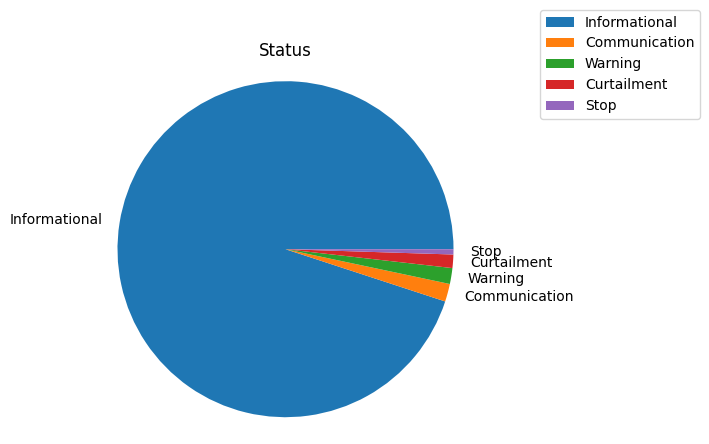

In [49]:
# Plot a pie chart to visualize the distribution of statuses in the merged_data
merged_data.Status.value_counts().plot.pie(title='Status', ylabel='')
plt.legend(bbox_to_anchor=(1, 1), loc='center left')
plt.axis('equal')
plt.show()



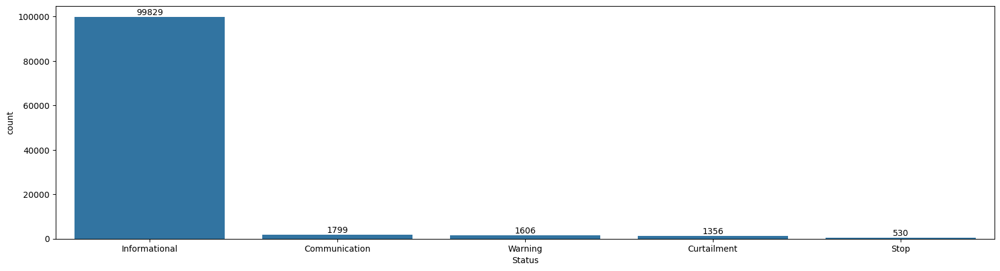

In [120]:
# Create a count plot to visualize the distribution of statuses in the merged_data
plt.figure(figsize=(20, 5))
ax = sns.countplot(data=merged_data, x="Status", order=merged_data['Status'].value_counts(ascending=False).index)

# Add labels with absolute values on top of each bar
abs_values = merged_data['Status'].value_counts(ascending=False).values
ax.bar_label(container=ax.containers[0], labels=abs_values)

plt.show()


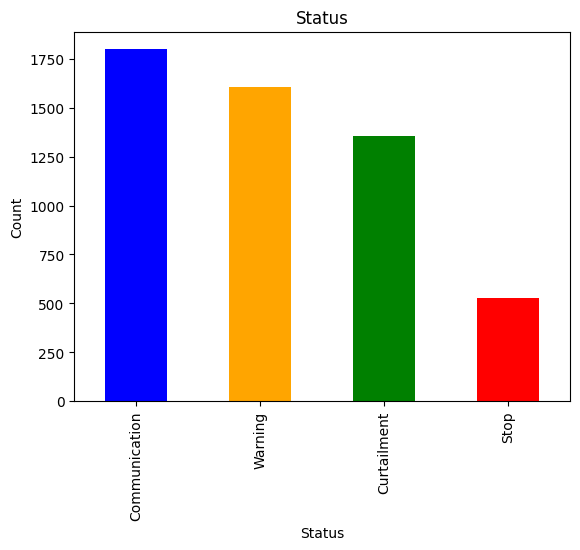

In [136]:
# Creating a color map for each value
colors = ['blue', 'orange', 'green', 'red']

# Plotting the bar chart with different colors for each value
merged_data.Status.value_counts().tail(4).plot(kind="bar", color=colors)

# Adding title and labels
plt.title('Status')
plt.xlabel('Status')
plt.ylabel('Count')

# Displaying the plot
plt.show()

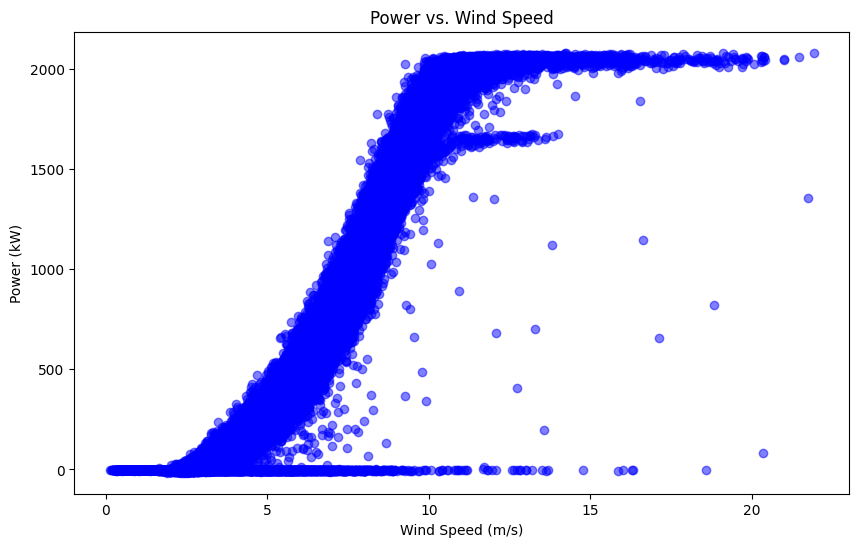

In [133]:
# Create scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(merged_data["Wind speed (m/s)"], merged_data["Power (kW)"], color='blue', alpha=0.5)
plt.title('Power vs. Wind Speed')
plt.xlabel('Wind Speed (m/s)')
plt.ylabel('Power (kW)')
plt.show()

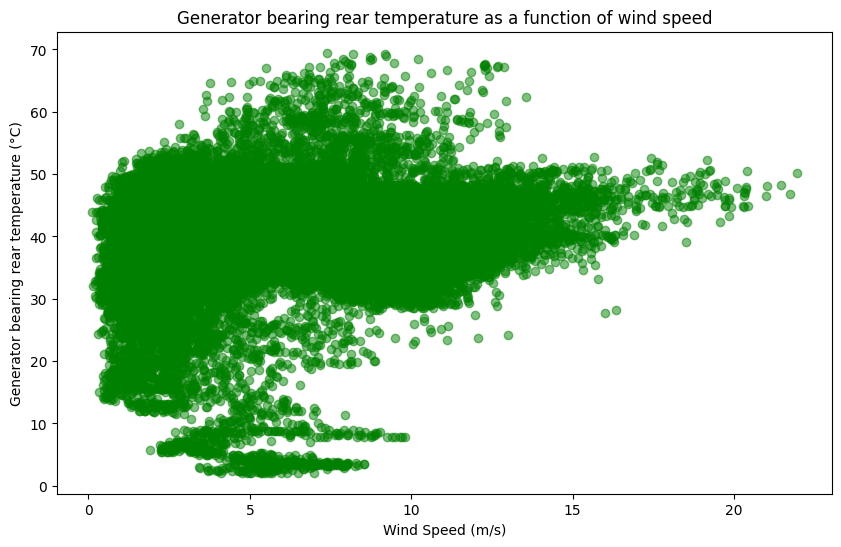

In [132]:
# Create scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(merged_data["Wind speed (m/s)"], merged_data["Generator bearing rear temperature (°C)"], color='green', alpha=0.5)
plt.title('Generator bearing rear temperature as a function of wind speed')
plt.xlabel('Wind Speed (m/s)')
plt.ylabel('Generator bearing rear temperature (°C)')
plt.show()

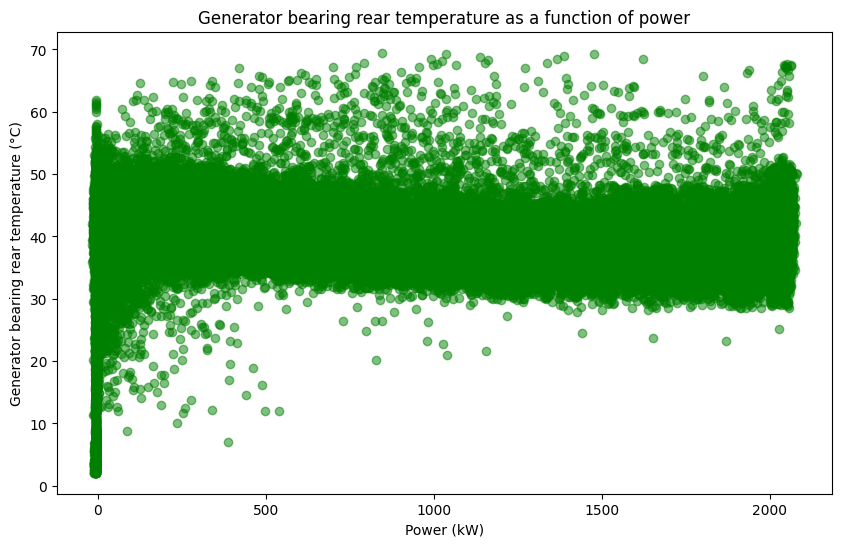

In [131]:
# Create scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(merged_data["Power (kW)"], merged_data["Generator bearing rear temperature (°C)"], color='green', alpha=0.5)
plt.title('Generator bearing rear temperature as a function of power')
plt.xlabel('Power (kW)')
plt.ylabel('Generator bearing rear temperature (°C)')
plt.show()

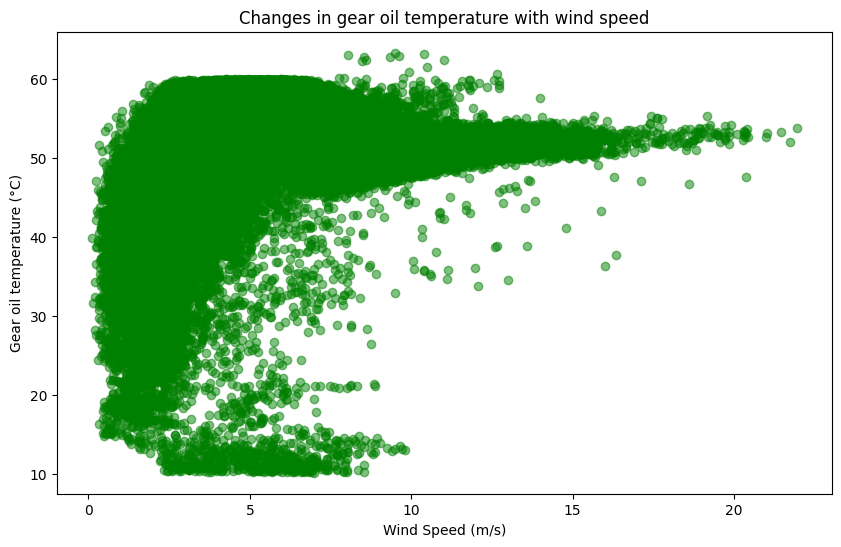

In [130]:
# Create scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(merged_data["Wind speed (m/s)"], merged_data["Gear oil temperature (°C)"], color='green', alpha=0.5)
plt.title('Changes in gear oil temperature with wind speed')
plt.xlabel('Wind Speed (m/s)')
plt.ylabel('Gear oil temperature (°C)')
plt.show()

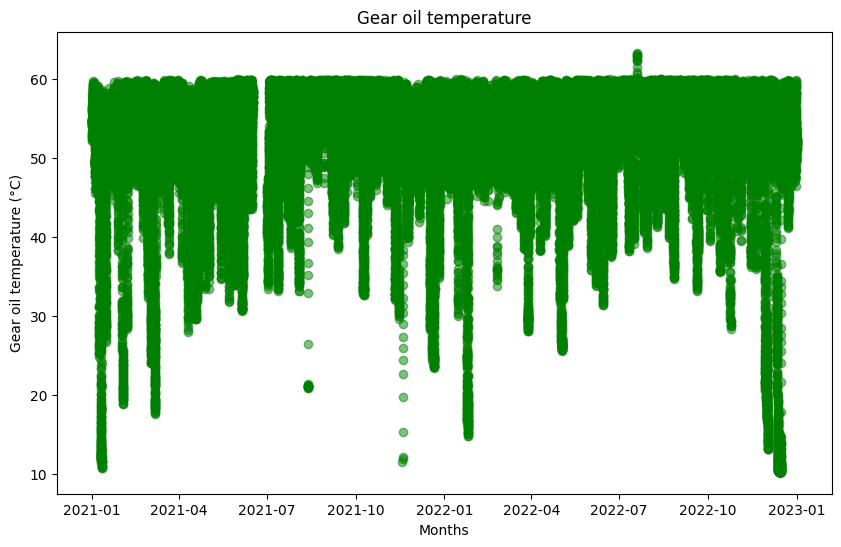

In [135]:
# Create scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(merged_data["Date and time"], merged_data["Gear oil temperature (°C)"], color='green', alpha=0.5)
plt.title('Gear oil temperature')
plt.xlabel('Months')
plt.ylabel('Gear oil temperature (°C)')
plt.show()

In [51]:
# Create a dataframe for warning events
warning_df = merged_data[merged_data['Status'] == "Warning"]

In [52]:
# Check warning (mulfunction) types
warning_df['Message'].unique()

array(['Heating/fan top box faulty', 'High yaw motor current',
       'Brake accumulator defect', 'Overload generator fan 3',
       'Battery charge cycle axis 3 error', 'Timeout brake closed',
       'Overload generator fan 1', 'Brake pads worn',
       'Overload generator heating', 'Check time synchronization',
       'Pitch batteries charging cycle', 'UPS warning',
       'Comm. failure FPM', 'Repeating error BP 0'], dtype=object)

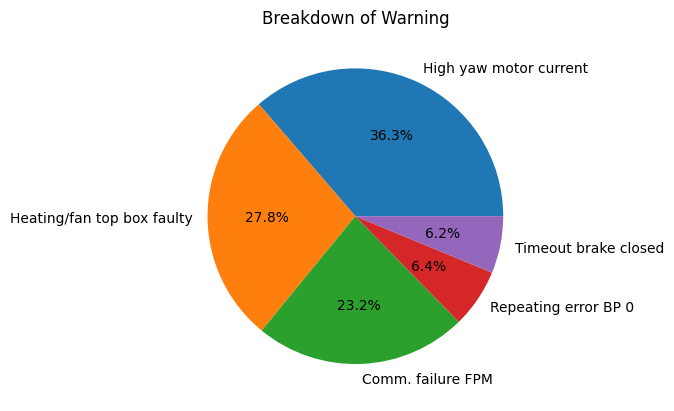

In [137]:
# Focus on only top five malfunction modes to see the distribution of most frequent ones
top_5_faults = warning_df['Message'].value_counts().head(5)

# Plotting the pie chart with percentages
top_5_faults.plot.pie(title='Breakdown of Warning', ylabel='', autopct='%1.1f%%')

# Displaying the plot
plt.show()


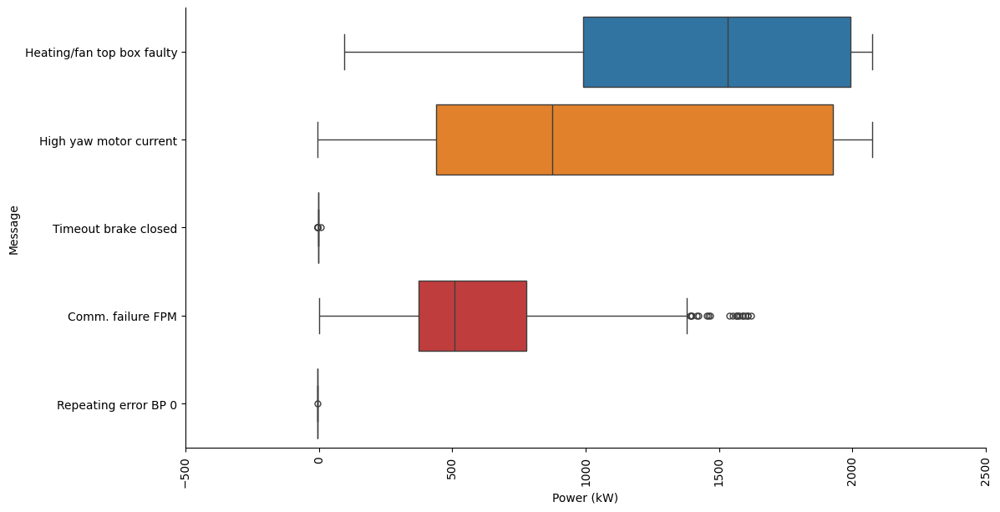

In [158]:
# Boxplot of power during malfunctioning
plot = sns.catplot(data=merged_data[merged_data['Message'].isin(['Heating/fan top box faulty',
           'High yaw motor current', 'Repeating error BP 0',
            'Timeout brake closed', 'Comm. failure FPM'])], 
            x='Power (kW)',
            y='Message', 
            kind='box',
            height=6,
            aspect=2,
            hue='Message',
            legend=False) 


# Optionally, rotate the x-axis labels for better readability
plot.set_xticklabels(rotation=90)

# Show the plot
plt.show()

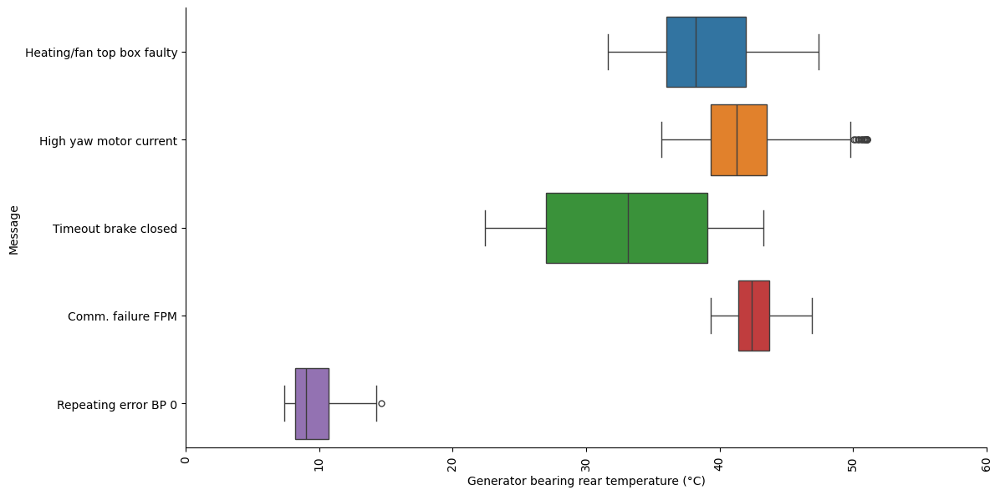

In [157]:
# Boxplot of Generator bearing rear temperature during malfunctioning
plot = sns.catplot(data=merged_data[merged_data['Message'].isin(['Heating/fan top box faulty',
           'High yaw motor current', 'Repeating error BP 0',
            'Timeout brake closed', 'Comm. failure FPM'])], 
            x='Generator bearing rear temperature (°C)', 
            y='Message',
            kind='box',
            height=6,
            aspect=2,
            hue='Message',
            legend=False) 

# Rotate the x-axis labels for better readability
plot.set_xticklabels(rotation=90)

# Show the plot
plt.show()

Engineered a new column named "Fault" to serve as the target variable for the Supervised Machine Learning Models. Leveraging information from the "Status" column, categorized it into three distinct classes. Instances labeled as "Stop" denote failures, those labeled as "Warning" signify malfunctions, while the remaining instances are classified as "System OK," indicating normal functioning.

In [54]:
# Create Fault column to assign the turbine conditions. Fault & No fault 
merged_data["Fault"] = merged_data["Status"].apply(lambda status: "Failure" if status == 'Stop'
                       else ("Malfunction" if status == "Warning" else "System OK"))    


In [55]:
# Drop specified columns directly as they are not providing any insights
merged_data.drop(columns=["Timestamp start", "Timestamp end", "Duration", "Priority"], inplace=True)

In [56]:
# Genral check of the data
merged_data.head()

,Date and time,Wind speed (m/s),"Wind speed, Standard deviation (m/s)",Long Term Wind (m/s),Wind speed Sensor 1 (m/s),Wind speed Sensor 2 (m/s),Density adjusted wind speed (m/s),Wind direction (°),Nacelle position (°),Vane position 1+2 (°),...,Metal particle count,Metal particle count counter,Drive train acceleration (mm/ss),Tower Acceleration X (mm/ss),Tower Acceleration y (mm/ss),Status,Code,Message,IEC category,Fault
0,2021-01-01 00:00:00,5.608035,0.376982,7.21,5.417486,5.430262,5.651862,304.503192,292.068848,13.134746,...,0.0,427.0,2.773602,22.596176,10.287351,Informational,100210,Mains operation,NaN,System OK
1,2021-01-01 00:10:00,5.656520,0.525513,7.21,5.638720,5.679798,5.703484,303.958125,292.068848,10.669749,...,0.0,427.0,3.179510,34.832909,14.871085,Informational,100210,Mains operation,NaN,System OK
2,2021-01-01 00:20:00,5.530760,0.548634,7.21,5.498362,5.555912,5.581883,302.359788,292.068848,10.361217,...,0.0,427.0,3.626123,40.580733,15.981503,Informational,100210,Mains operation,NaN,System OK
3,2021-01-01 00:30:00,5.178295,0.667335,7.21,5.435474,5.486042,5.228316,305.378038,292.068848,11.722375,...,0.0,427.0,3.743809,55.724571,23.814625,Informational,100210,Mains operation,NaN,System OK
4,2021-01-01 00:40:00,5.745138,0.512055,7.21,5.528419,5.422410,5.800280,296.362417,292.068848,1.755778,...,0.0,427.0,4.056096,37.824323,17.453197,Informational,100210,Mains operation,NaN,System OK


In [57]:
# Convert the 'Code' column to float data type in the merged_data to have alignment
merged_data['Code'] = merged_data['Code'].astype(float)

In [58]:
# Select columns with object data type (categorical columns) from the merged_data
categorical_col = merged_data.select_dtypes(include=['object'])
categorical_col

,Status,Message,IEC category,Fault
0,Informational,Mains operation,NaN,System OK
1,Informational,Mains operation,NaN,System OK
2,Informational,Mains operation,NaN,System OK
3,Informational,Mains operation,NaN,System OK
4,Informational,Mains operation,NaN,System OK
...,...,...,...,...
105115,Informational,Mains operation,Full Performance,System OK
105116,Informational,Mains operation,Full Performance,System OK
105117,Informational,Mains operation,Full Performance,System OK
105118,Informational,Mains operation,Full Performance,System OK


In [59]:
# Iterate over each categorical column and print the number of unique values in each column
for col in categorical_col:
    print(col, merged_data[col].nunique())

Status 5
Message 55
IEC category 8
Fault 3


In [60]:
# As the fault column is target value for ML Models, it is extracted from Binary Encoder
categorical_col = merged_data[['Status','Message','IEC category']]

In [61]:
# Initialize a BinaryEncoder
encoder = ce.BinaryEncoder()

# Fit and transform the categorical columns
data_encoded = encoder.fit_transform(categorical_col)

In [62]:
# Concatenate the original merged_data with the encoded categorical data along the columns (axis=1)
data_merged_encoded = pd.concat([merged_data, data_encoded], axis=1)
data_merged_encoded


,Date and time,Wind speed (m/s),"Wind speed, Standard deviation (m/s)",Long Term Wind (m/s),Wind speed Sensor 1 (m/s),Wind speed Sensor 2 (m/s),Density adjusted wind speed (m/s),Wind direction (°),Nacelle position (°),Vane position 1+2 (°),...,Message_0,Message_1,Message_2,Message_3,Message_4,Message_5,IEC category_0,IEC category_1,IEC category_2,IEC category_3
0,2021-01-01 00:00:00,5.608035,0.376982,7.21,5.417486,5.430262,5.651862,304.503192,292.068848,13.134746,...,0,0,0,0,0,1,1,0,0,1
1,2021-01-01 00:10:00,5.656520,0.525513,7.21,5.638720,5.679798,5.703484,303.958125,292.068848,10.669749,...,0,0,0,0,0,1,1,0,0,1
2,2021-01-01 00:20:00,5.530760,0.548634,7.21,5.498362,5.555912,5.581883,302.359788,292.068848,10.361217,...,0,0,0,0,0,1,1,0,0,1
3,2021-01-01 00:30:00,5.178295,0.667335,7.21,5.435474,5.486042,5.228316,305.378038,292.068848,11.722375,...,0,0,0,0,0,1,1,0,0,1
4,2021-01-01 00:40:00,5.745138,0.512055,7.21,5.528419,5.422410,5.800280,296.362417,292.068848,1.755778,...,0,0,0,0,0,1,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105115,2022-12-31 23:10:00,7.153512,1.393895,6.77,7.733686,7.441713,7.129925,216.697888,213.043030,3.658465,...,0,0,0,0,0,1,0,0,1,0
105116,2022-12-31 23:20:00,7.491813,1.379049,6.77,7.748282,7.375594,7.467001,209.175400,213.043030,-4.511012,...,0,0,0,0,0,1,0,0,1,0
105117,2022-12-31 23:30:00,8.186162,1.880318,6.77,8.664593,8.179925,8.159050,217.964423,213.043030,2.861510,...,0,0,0,0,0,1,0,0,1,0
105118,2022-12-31 23:40:00,8.586258,1.503022,6.77,9.246856,8.905886,8.557847,216.244529,213.043030,3.776807,...,0,0,0,0,0,1,0,0,1,0


In [63]:
# Drop the columns 'Status', 'Message', and 'IEC category' from the data_merged_encoded 
# as the data has already encoded versions of those columns
data_merged_encoded.drop(['Status', 'Message', 'IEC category'], axis=1, inplace=True)

# <img src="./data/imputation.png" alt="Imputation Icon" width="30"/> **Data Imputation**

To accurately impute missing values, three separate DataFrames were created corresponding to the three target statuses: Failure, Malfunction, and System OK. The forward fill (ffill) method was then applied to ensure missing values were imputed based on reasonable forward values. This strategy was implemented because each status category may follow its own distinct flow. By imputing missing values separately for each category, the risk of incorrect imputation is minimized. For instance, if a failure status is missing but the forward column contains a value from the System OK category, imputing based on the overall data would lead to inaccuracies. Therefore, the approach of segmenting the data by status categories ensures more precise imputation tailored to each specific flow.

In [64]:
# Filter rows with "Failure" in the "Fault" column
merged_data_failure = data_merged_encoded[data_merged_encoded["Fault"] == "Failure"]

# Filter rows with "Malfunction" in the "Fault" column
merged_data_malfunction = data_merged_encoded[data_merged_encoded["Fault"] == "Malfunction"]

# Filter rows with "System OK" in the "Fault" column
merged_data_system_ok = data_merged_encoded[data_merged_encoded["Fault"] == "System OK"]

In [65]:
# Check missing values
merged_data_failure.isna().sum()

Date and time                            0
Wind speed (m/s)                         1
Wind speed, Standard deviation (m/s)     1
Long Term Wind (m/s)                     0
Wind speed Sensor 1 (m/s)               85
                                        ..
Message_5                                0
IEC category_0                           0
IEC category_1                           0
IEC category_2                           0
IEC category_3                           0
Length: 142, dtype: int64

In [66]:
# Calculate the number of missing values in each column of the merged_data_failure 
# and sort them in descending order
missing_values1 = merged_data_failure.isna().sum().sort_values(ascending=False)
missing_values1.head(15)


Tower Acceleration y (mm/ss)             291
Metal particle count counter             291
Gear oil inlet temperature (°C)          291
Gearbox speed (RPM)                      291
Nacelle temperature (°C)                 291
Nacelle ambient temperature (°C)         291
Rear bearing temperature (°C)            291
Front bearing temperature (°C)           291
Gear oil temperature (°C)                291
Tower Acceleration X (mm/ss)             291
Current L3 / W (A)                       291
Blade angle (pitch position) C (°)       291
Cable windings from calibration point    291
Current L2 / V (A)                       291
Current L1 / U (A)                       291
dtype: int64

In [67]:
# Columns to ignore during imputation
ignore_columns = ['Fault', "Date and time"]

# Identify numeric columns, excluding the specified ignore columns
columns_to_impute = [col for col in merged_data_failure.columns if merged_data_failure[col].dtype in [np.float64, np.int64] and col not in ignore_columns]

# Perform forward fill imputation using .loc
merged_data_failure.loc[:, columns_to_impute] = merged_data_failure.loc[:, columns_to_impute].fillna(method='ffill')


In [68]:
# Sanity check
missing_values1 = merged_data_failure.isna().sum().sort_values(ascending=False)
missing_values1.head(15)

Performance Index                                  130
Date and time                                        0
Production-based Contractual Avail. (Custom)         0
Time-based Contractual Avail.                        0
Time-based IEC B.2.2 (Users View)                    0
Time-based IEC B.2.3 (Users View)                    0
Time-based IEC B.2.4 (Users View)                    0
Time-based IEC B.3.2 (Manufacturers View)            0
Production-based IEC B.2.2 (Users View)              0
Production-based IEC B.3.2 (Manufacturers View)      0
Time-based System Avail.                             0
Production-based System Avail.                       0
Production-based Contractual Avail.                  0
Time-based System Avail. (Planned)                   0
Production-based System Avail. (virtual)             0
dtype: int64

In [69]:
# Remove "Perfomance Index" as it is not providing any insights
merged_data_failure = merged_data_failure.loc[:, merged_data_failure.columns != "Performance Index"]

In [70]:
# Sanity check
missing_values1 = merged_data_failure.isna().sum().sort_values(ascending=False)
missing_values1.head(15)

Date and time                                      0
Production-based IEC B.3.2 (Manufacturers View)    0
Time-based Contractual Avail.                      0
Time-based IEC B.2.2 (Users View)                  0
Time-based IEC B.2.3 (Users View)                  0
Time-based IEC B.2.4 (Users View)                  0
Time-based IEC B.3.2 (Manufacturers View)          0
Production-based IEC B.2.2 (Users View)            0
Time-based System Avail.                           0
Capacity factor                                    0
Production-based System Avail.                     0
Production-based Contractual Avail.                0
Time-based System Avail. (Planned)                 0
Production-based System Avail. (virtual)           0
Time-based Contractual Avail. (Global)             0
dtype: int64

In [71]:
# Calculate the number of missing values in each column of the merged_data_malfunction 
# and sort them in descending order
missing_values2 = merged_data_malfunction.isna().sum().sort_values(ascending=False)
missing_values2.head(15)

Performance Index                                     311
Wind speed Sensor 1 (m/s)                             135
Potential power primary reference turbines (kW)       124
Production-based IEC B.3.2 (Manufacturers View)       115
Time-based IEC B.3.2 (Manufacturers View)             114
Lost Production (Production-based IEC B.3.2) (kWh)    114
Lost Production (Time-based IEC B.3.2) (kWh)          114
Potential power secondary reference turbines (kW)     110
Potential power reference turbines (kW)               104
Rear bearing temperature (°C)                          57
Tower Acceleration y (mm/ss)                           57
Transformer temperature (°C)                           57
Voltage L3 / W (V)                                     57
Voltage L2 / V (V)                                     57
Voltage L1 / U (V)                                     57
dtype: int64

In [72]:
# Identify numeric columns, excluding the specified ignore columns
columns_to_impute = [col for col in merged_data_malfunction.columns if merged_data_malfunction[col].dtype in [np.float64, np.int64] and col not in ignore_columns]

# Perform forward fill imputation using .loc
merged_data_malfunction.loc[:, columns_to_impute] = merged_data_malfunction.loc[:, columns_to_impute].fillna(method='ffill')

In [73]:
# Sanity check
missing_values2 = merged_data_malfunction.isna().sum().sort_values(ascending=False)
missing_values2.head(15)

Date and time                                      0
Production-based IEC B.3.2 (Manufacturers View)    0
Time-based Contractual Avail.                      0
Time-based IEC B.2.2 (Users View)                  0
Time-based IEC B.2.3 (Users View)                  0
Time-based IEC B.2.4 (Users View)                  0
Time-based IEC B.3.2 (Manufacturers View)          0
Production-based IEC B.2.2 (Users View)            0
Time-based System Avail.                           0
Capacity factor                                    0
Production-based System Avail.                     0
Production-based Contractual Avail.                0
Time-based System Avail. (Planned)                 0
Production-based System Avail. (virtual)           0
Time-based Contractual Avail. (Global)             0
dtype: int64

In [74]:
# Remove "Perfomance Index" as it is not providing any insights
merged_data_malfunction = merged_data_malfunction.loc[:, merged_data_malfunction.columns != "Performance Index"]

In [75]:
# Sanity check
missing_values3 = merged_data_system_ok.isna().sum().sort_values(ascending=False)
missing_values3.head(15)

Reactive Energy Export (kvarh)           3681
Rear bearing temperature (°C)            3136
Transformer cell temperature (°C)        3136
Voltage L2 / V (V)                       3136
Voltage L3 / W (V)                       3136
Tower Acceleration y (mm/ss)             3136
Current L1 / U (A)                       3136
Current L2 / V (A)                       3136
Current L3 / W (A)                       3136
Tower Acceleration X (mm/ss)             3136
Metal particle count counter             3136
Transformer temperature (°C)             3136
Cable windings from calibration point    3136
Voltage L1 / U (V)                       3136
Nacelle temperature (°C)                 3136
dtype: int64

In [76]:
# Identify numeric columns, excluding the specified ignore columns
columns_to_impute = [col for col in merged_data_system_ok.columns if merged_data_system_ok[col].dtype in [np.float64, np.int64] and col not in ignore_columns]

# Perform forward fill imputation using .loc
merged_data_system_ok.loc[:, columns_to_impute] = merged_data_system_ok.loc[:, columns_to_impute].fillna(method='ffill')

In [77]:
# Calculate the number of missing values in each column of the merged_data_malfunction 
# and sort them in descending order
missing_values3 = merged_data_system_ok.isna().sum().sort_values(ascending=False)
missing_values3.head(15)

Date and time                                      0
Production-based IEC B.3.2 (Manufacturers View)    0
Time-based Contractual Avail.                      0
Time-based IEC B.2.2 (Users View)                  0
Time-based IEC B.2.3 (Users View)                  0
Time-based IEC B.2.4 (Users View)                  0
Time-based IEC B.3.2 (Manufacturers View)          0
Production-based IEC B.2.2 (Users View)            0
Time-based System Avail.                           0
Capacity factor                                    0
Production-based System Avail.                     0
Production-based Contractual Avail.                0
Time-based System Avail. (Planned)                 0
Production-based System Avail. (virtual)           0
Time-based Contractual Avail. (Global)             0
dtype: int64

In [78]:
# Remove "Perfomance Index" as it is not providing any insights
merged_data_system_ok = merged_data_system_ok.loc[:, merged_data_system_ok.columns != "Performance Index"]

In [79]:
# Concatenate all DataFrame's
merged_data_ml = pd.concat([merged_data_failure, merged_data_malfunction, merged_data_system_ok])

# Sort the DataFrame by the "Date and time" column
merged_data_ml.sort_values(by='Date and time', inplace=True)

# Reset index
merged_data_ml.reset_index(drop=True, inplace=True)

In [80]:
# Final check if there is any missing values
merged_data_ml.isna().sum()

Date and time                           0
Wind speed (m/s)                        0
Wind speed, Standard deviation (m/s)    0
Long Term Wind (m/s)                    0
Wind speed Sensor 1 (m/s)               0
                                       ..
Message_5                               0
IEC category_0                          0
IEC category_1                          0
IEC category_2                          0
IEC category_3                          0
Length: 141, dtype: int64

In [81]:
# General look of the final data
merged_data_ml.head()

,Date and time,Wind speed (m/s),"Wind speed, Standard deviation (m/s)",Long Term Wind (m/s),Wind speed Sensor 1 (m/s),Wind speed Sensor 2 (m/s),Density adjusted wind speed (m/s),Wind direction (°),Nacelle position (°),Vane position 1+2 (°),...,Message_0,Message_1,Message_2,Message_3,Message_4,Message_5,IEC category_0,IEC category_1,IEC category_2,IEC category_3
0,2021-01-01 00:00:00,5.608035,0.376982,7.21,5.417486,5.430262,5.651862,304.503192,292.068848,13.134746,...,0,0,0,0,0,1,1,0,0,1
1,2021-01-01 00:10:00,5.656520,0.525513,7.21,5.638720,5.679798,5.703484,303.958125,292.068848,10.669749,...,0,0,0,0,0,1,1,0,0,1
2,2021-01-01 00:20:00,5.530760,0.548634,7.21,5.498362,5.555912,5.581883,302.359788,292.068848,10.361217,...,0,0,0,0,0,1,1,0,0,1
3,2021-01-01 00:30:00,5.178295,0.667335,7.21,5.435474,5.486042,5.228316,305.378038,292.068848,11.722375,...,0,0,0,0,0,1,1,0,0,1
4,2021-01-01 00:40:00,5.745138,0.512055,7.21,5.528419,5.422410,5.800280,296.362417,292.068848,1.755778,...,0,0,0,0,0,1,1,0,0,1


In [82]:
# Remove "Performance Index" as it is not providing any insights
merged_data_ml = merged_data_ml.loc[:, merged_data_ml.columns != "Performance Index"]

In [83]:
# Final version of the data before implementing ML Models
merged_data_ml.head()

,Date and time,Wind speed (m/s),"Wind speed, Standard deviation (m/s)",Long Term Wind (m/s),Wind speed Sensor 1 (m/s),Wind speed Sensor 2 (m/s),Density adjusted wind speed (m/s),Wind direction (°),Nacelle position (°),Vane position 1+2 (°),...,Message_0,Message_1,Message_2,Message_3,Message_4,Message_5,IEC category_0,IEC category_1,IEC category_2,IEC category_3
0,2021-01-01 00:00:00,5.608035,0.376982,7.21,5.417486,5.430262,5.651862,304.503192,292.068848,13.134746,...,0,0,0,0,0,1,1,0,0,1
1,2021-01-01 00:10:00,5.656520,0.525513,7.21,5.638720,5.679798,5.703484,303.958125,292.068848,10.669749,...,0,0,0,0,0,1,1,0,0,1
2,2021-01-01 00:20:00,5.530760,0.548634,7.21,5.498362,5.555912,5.581883,302.359788,292.068848,10.361217,...,0,0,0,0,0,1,1,0,0,1
3,2021-01-01 00:30:00,5.178295,0.667335,7.21,5.435474,5.486042,5.228316,305.378038,292.068848,11.722375,...,0,0,0,0,0,1,1,0,0,1
4,2021-01-01 00:40:00,5.745138,0.512055,7.21,5.528419,5.422410,5.800280,296.362417,292.068848,1.755778,...,0,0,0,0,0,1,1,0,0,1


# <img src="./data/dataselection.png" alt="Feature Selection Icon" width="30"/> **Feature Selection**

In [84]:
# Replace categorical labels in the "Fault" column with numerical values for machine learning purposes
merged_data_ml["Fault"] = merged_data_ml["Fault"].replace("System OK", 0)
merged_data_ml["Fault"] = merged_data_ml["Fault"].replace("Malfunction", 1)
merged_data_ml["Fault"] = merged_data_ml["Fault"].replace("Failure", 2)

# Convert the "Fault" column to integer data type
merged_data_ml["Fault"] = merged_data_ml["Fault"].astype(int)

In [85]:
# Define X and y
X = merged_data_ml.drop(columns=['Code', 'Fault', 'Status_0', 'Status_1',
       'Status_2', 'Message_0', 'Message_1', 'Message_2', 'Message_3',
       'Message_4', 'Message_5', 'IEC category_0', 'IEC category_1',
       'IEC category_2', 'IEC category_3', 'Date and time'])
y = merged_data_ml['Fault']

# Perform train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [86]:
# Initialize StandardScaler
scaler = StandardScaler()

# Standardize the features
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [87]:
# Choose the number of components you want to keep
pca = PCA(n_components=34)

# Fit and transform PCA on the training set
X_train_pca = pca.fit_transform(X_train_scaled)

# Transform testing sets using the fitted PCA models
X_test_pca = pca.transform(X_test_scaled)

# principal components and explained variance ratio
explained_variance_ratio = pca.explained_variance_ratio_
principal_components = pca.components_

In [88]:
# Check selected principal components
principal_components

array([[ 0.15173093,  0.11882775,  0.05428735, ...,  0.13997211,
         0.10354496,  0.13788819],
       [ 0.03984352,  0.03291662,  0.06743082, ...,  0.02999393,
        -0.02867849,  0.00880054],
       [ 0.02967798,  0.07254499, -0.21188244, ...,  0.02418329,
         0.03479058,  0.03779601],
       ...,
       [ 0.08713531,  0.17843067, -0.00326512, ..., -0.0125233 ,
        -0.18541128, -0.00181372],
       [ 0.04538215, -0.12157202, -0.01108779, ...,  0.05863956,
         0.27390394,  0.34769131],
       [ 0.02616951, -0.07571825,  0.00876299, ...,  0.01224586,
         0.05167648,  0.0882711 ]])

In [89]:
# Aim for a high explained_variance_ratio to maximize component relationships
explained_variance_ratio.sum()

0.9802601913746292

In [90]:
# Apply SMOTE for oversampling the minority class to balance the data
smote = SMOTE(random_state=42)

# Apply SMOTE to the training data
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_pca, y_train)

In [91]:
# Training data before SMOTE
y_train.value_counts()

Fault
0    82403
1     1275
2      418
Name: count, dtype: int64

In [92]:
# Check final training data after SMOTE
y_train_resampled.value_counts()

Fault
0    82403
1    82403
2    82403
Name: count, dtype: int64

In [93]:
# Define opacity values for each class
opacities = [0.5, 0.7, 0.9]  # Adjust opacity values as needed
class_labels = ['System OK', 'Malfunction', 'Fault']  # Desired labels for each class
class_colors = ['green', 'yellow', 'red']  # Desired colors for each class

# Create a scatter plot using Plotly
fig = go.Figure()

# Add a scatter plot for the data points with transparency and color-coded by class
for label in np.unique(y_train):
    class_indices = y_train == label
    fig.add_trace(go.Scatter(x=X_train_pca[class_indices, 0], 
                             y=X_train_pca[class_indices, 1], 
                             mode='markers',
                             marker=dict(color=class_colors[label], size=5, opacity=opacities[label]),
                             showlegend=True,
                             name=class_labels[label]))  # Set name to the desired label

# Set axis labels and title
fig.update_layout(xaxis_title='Feature 1',
                  yaxis_title='Feature 2',
                  title='Classes Before SMOTE')

# Show the plot
fig.show()


![Chart1](./data/chart1.png)

In [94]:
# Define opacity values for each class
opacities = [0.5, 0.7, 0.9]  # Adjust opacity values as needed
class_labels = ['System OK', 'Malfunction', 'Fault']  # Desired labels for each class
class_colors = ['green', 'yellow', 'red']  # Desired colors for each class

# Create a scatter plot using Plotly
fig = go.Figure()

# Add a scatter plot for the data points with transparency and color-coded by class
for label in np.unique(y_train_resampled):
    class_indices = y_train_resampled == label
    fig.add_trace(go.Scatter(x=X_train_resampled[class_indices, 0], 
                             y=X_train_resampled[class_indices, 1], 
                             mode='markers',
                             marker=dict(color=class_colors[label], size=5, opacity=opacities[label]),
                             showlegend=True,
                             name=class_labels[label]))  # Set name to the desired label

# Set axis labels and title
fig.update_layout(xaxis_title='Feature 1',
                  yaxis_title='Feature 2',
                  title='Classes After SMOTE')

# Show the plot
fig.show()



![Chart2](./data/chart2.png)

# <img src="./data/ml-models.png" alt="Predictive Models Icon" width="30"/> **Supervised Machine Learning Models**

## Random Forest Model (RF)

In [95]:
# Train the random forest classifier using the resampled training data
rf_classifier = RandomForestClassifier(random_state=42)
rf_classifier.fit(X_train_resampled, y_train_resampled)

# Predict on the test set
y_pred_rf = rf_classifier.predict(X_test_pca)

# Evaluate the model
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_rf))
print("\nClassification Report:")
print(classification_report(y_test, y_pred_rf))

Confusion Matrix:
[[20505    65    11]
 [   68   263     0]
 [   10     4    98]]

Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     20581
           1       0.79      0.79      0.79       331
           2       0.90      0.88      0.89       112

    accuracy                           0.99     21024
   macro avg       0.90      0.89      0.89     21024
weighted avg       0.99      0.99      0.99     21024



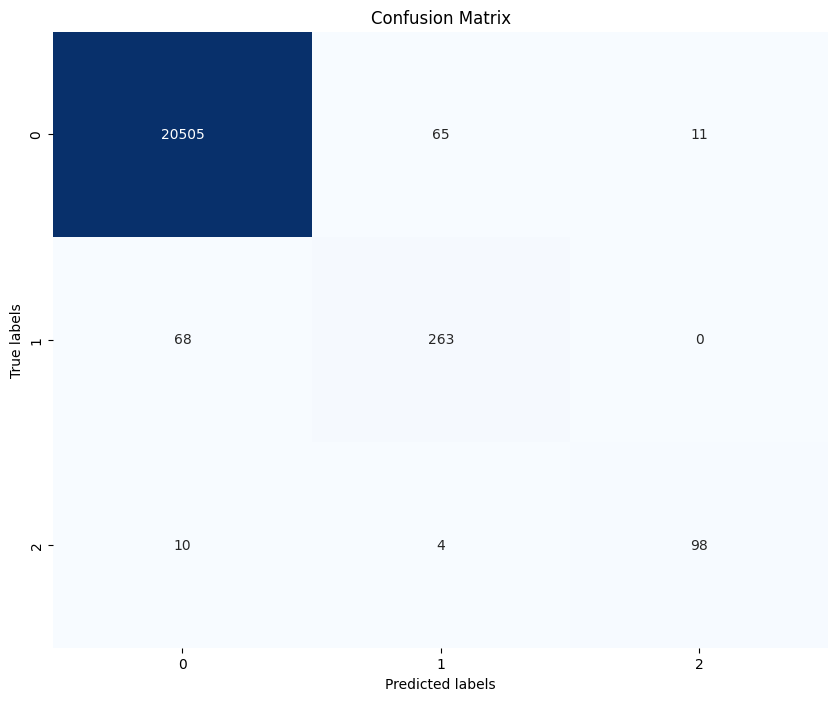

In [96]:
# Calculate confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred_rf)

# Plot confusion matrix as heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

## Support Vector Machine Model (SVM)

In [97]:
# Instantiate the SVM classifier
svm_poly = SVC(kernel='poly', random_state=42)

# Fit the classifier to the resampled training data
svm_poly.fit(X_train_resampled, y_train_resampled)

# Predict on the test set
y_pred_poly = svm_poly.predict(X_test_pca)

# Evaluate the model
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_poly))
print("\nClassification Report:")
print(classification_report(y_test, y_pred_poly))

Confusion Matrix:
[[19638   872    71]
 [   82   249     0]
 [    1     1   110]]

Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.95      0.97     20581
           1       0.22      0.75      0.34       331
           2       0.61      0.98      0.75       112

    accuracy                           0.95     21024
   macro avg       0.61      0.90      0.69     21024
weighted avg       0.98      0.95      0.96     21024



In [98]:
# Instantiate the SVM classifier
svm_rbf = SVC(kernel='rbf', random_state=42)

# Fit the classifier to the resampled training data
svm_rbf.fit(X_train_resampled, y_train_resampled)

# Predict on the test set
y_pred_rbf = svm_rbf.predict(X_test_pca)

# Evaluate the model
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_rbf))
print("\nClassification Report:")
print(classification_report(y_test, y_pred_rbf))

Confusion Matrix:
[[19027  1467    87]
 [   10   321     0]
 [    3     4   105]]

Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.92      0.96     20581
           1       0.18      0.97      0.30       331
           2       0.55      0.94      0.69       112

    accuracy                           0.93     21024
   macro avg       0.58      0.94      0.65     21024
weighted avg       0.98      0.93      0.95     21024



In [99]:
# Instantiate the SVM classifier
svm_linear = SVC(kernel='linear', random_state=42)

# Fit the classifier to the resampled training data
svm_linear.fit(X_train_resampled, y_train_resampled)

# Predict on the test set
y_pred_linear = svm_linear.predict(X_test_pca)

# Evaluate the model
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_linear))
print("\nClassification Report:")
print(classification_report(y_test, y_pred_linear))

Confusion Matrix:
[[18100  2369   112]
 [   14   312     5]
 [    3     1   108]]

Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.88      0.94     20581
           1       0.12      0.94      0.21       331
           2       0.48      0.96      0.64       112

    accuracy                           0.88     21024
   macro avg       0.53      0.93      0.59     21024
weighted avg       0.98      0.88      0.92     21024



In [100]:
# Instantiate the SVM classifier
svm_sigmoid = SVC(kernel='sigmoid', random_state=42)

# Fit the classifier to the resampled training data
svm_sigmoid.fit(X_train_resampled, y_train_resampled)

# Predict on the test set
y_pred_sigmoid = svm_sigmoid.predict(X_test_pca)

# Evaluate the model
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_sigmoid))
print("\nClassification Report:")
print(classification_report(y_test, y_pred_sigmoid))

Confusion Matrix:
[[17285  2719   577]
 [   64   197    70]
 [    2    27    83]]

Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.84      0.91     20581
           1       0.07      0.60      0.12       331
           2       0.11      0.74      0.20       112

    accuracy                           0.84     21024
   macro avg       0.39      0.73      0.41     21024
weighted avg       0.98      0.84      0.90     21024



In [101]:
# Function to calculate precision, recall, and F1-score for each class
def calculate_metrics(y_test, y_pred):
    # Initialize dictionaries to store metrics for each class
    precision = {}
    recall = {}
    f1_score = {}
    
    # Calculate metrics for each class
    for class_label in set(y_test):
        tp = sum((y_test == class_label) & (y_pred == class_label))
        fp = sum((y_test != class_label) & (y_pred == class_label))
        fn = sum((y_test == class_label) & (y_pred != class_label))
        
        # Calculate precision, recall, and F1-score
        precision[class_label] = tp / (tp + fp) if (tp + fp) > 0 else 0
        recall[class_label] = tp / (tp + fn) if (tp + fn) > 0 else 0
        f1_score[class_label] = 2 * (precision[class_label] * recall[class_label]) / \
            (precision[class_label] + recall[class_label]) if (precision[class_label] + recall[class_label]) > 0 else 0
    
    return precision, recall, f1_score

# Calculate metrics for each kernel
precision_linear, recall_linear, f1_score_linear = calculate_metrics(y_test, y_pred_linear)
precision_poly, recall_poly, f1_score_poly = calculate_metrics(y_test, y_pred_poly)
precision_rbf, recall_rbf, f1_score_rbf = calculate_metrics(y_test, y_pred_rbf)
precision_sigmoid, recall_sigmoid, f1_score_sigmoid = calculate_metrics(y_test, y_pred_sigmoid)

# List of class labels
classes = set(y_test)

In [102]:
# Initialize dictionaries to store recall, precision, and F1-score values for each kernel and class
recall_values = {kernel: {class_label: 0 for class_label in classes} for kernel in ['Linear', 'Polynomial', 'RBF', 'Sigmoid']}
precision_values = {kernel: {class_label: 0 for class_label in classes} for kernel in ['Linear', 'Polynomial', 'RBF', 'Sigmoid']}
f1_score_values = {kernel: {class_label: 0 for class_label in classes} for kernel in ['Linear', 'Polynomial', 'RBF', 'Sigmoid']}

# Store recall, precision, and F1-score values for each kernel and class
for kernel, recall_scores, precision_scores, f1_scores in zip(['Linear', 'Polynomial', 'RBF', 'Sigmoid'], 
                                                              [recall_linear, recall_poly, recall_rbf, recall_sigmoid],
                                                              [precision_linear, precision_poly, precision_rbf, precision_sigmoid],
                                                              [f1_score_linear, f1_score_poly, f1_score_rbf, f1_score_sigmoid]):
    for class_label in classes:
        recall_values[kernel][class_label] = recall_scores[class_label]
        precision_values[kernel][class_label] = precision_scores[class_label]
        f1_score_values[kernel][class_label] = f1_scores[class_label]

# Create subplots for each class
fig = make_subplots(rows=3, cols=len(classes), subplot_titles=[f'Class {class_label}' for class_label in classes])

# Add traces for recall, precision, and F1-score for each kernel to the corresponding subplot
for i, class_label in enumerate(classes, start=1):
    for j, kernel in enumerate(['Linear', 'Polynomial', 'RBF', 'Sigmoid']):
        # Recall
        fig.add_trace(go.Bar(x=[kernel], y=[recall_values[kernel][class_label]],
                             name=f'{kernel}', marker_color='rgba(255, 69, 0, 0.7)', 
                             text=[f'{recall_values[kernel][class_label]:.2f}'],
                             textposition='auto'), row=1, col=i)
        # Precision
        fig.add_trace(go.Bar(x=[kernel], y=[precision_values[kernel][class_label]],
                             name=f'{kernel}', marker_color='rgba(100, 149, 237, 0.7)', 
                             text=[f'{precision_values[kernel][class_label]:.2f}'],
                             textposition='auto'), row=2, col=i)
        # F1-score
        fig.add_trace(go.Bar(x=[kernel], y=[f1_score_values[kernel][class_label]],
                             name=f'{kernel}', marker_color='rgba(60, 179, 113, 0.7)', 
                             text=[f'{f1_score_values[kernel][class_label]:.2f}'],
                             textposition='auto'), row=3, col=i)

# Update layout for Recall subplot
fig.update_layout(title='Recall, Precision, and F1-Score Comparison Across Kernels for Each Class', 
                  xaxis_title='Kernel',
                  height=800, width=1200)

# Add y-axis legends for Recall, Precision, and F1-Score subplots
fig.update_yaxes(title_text='Recall', row=1, col=1)
fig.update_yaxes(title_text='Precision', row=2, col=1)
fig.update_yaxes(title_text='F1-Score', row=3, col=1)

# Remove legend
fig.update_layout(showlegend=False)

# Show plot
fig.show()

![Chart3](./data/chart3.png)

## Gradient Boosting Model (GB)

In [103]:
# Define the GradientBoostingClassifier
gbc = GradientBoostingClassifier(n_estimators=300,
                                 learning_rate=0.05,
                                 random_state=100,
                                 max_features=5)

# Fit the classifier to the training data
gbc.fit(X_train_resampled, y_train_resampled)

# Predict on the test set
y_pred_gbc = gbc.predict(X_test_pca)

# Generate classification report
class_report = classification_report(y_test, y_pred_gbc)

# Print the Evaluation Metrics
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_gbc))
print("Classification Report:")
print(class_report)

Confusion Matrix:
[[19342  1145    94]
 [   19   311     1]
 [    2     1   109]]
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.94      0.97     20581
           1       0.21      0.94      0.35       331
           2       0.53      0.97      0.69       112

    accuracy                           0.94     21024
   macro avg       0.58      0.95      0.67     21024
weighted avg       0.98      0.94      0.96     21024



## Artificial Neural Network Model (ANN)

In [104]:
# Define the ANN model
ann_model = Sequential([
    Dense(64, activation='relu', input_shape=(X_train_resampled.shape[1],)),
    Dropout(0.5),
    Dense(32, activation='relu'),
    Dropout(0.5),
    Dense(16, activation='relu'),
    Dense(3, activation='softmax')
])

In [105]:
# Choose optimizer and learning rate
opt = Adam(learning_rate=0.0001)

# Compile the model
ann_model.compile(
    optimizer=opt,
    loss='sparse_categorical_crossentropy', 
    metrics=['accuracy']
)

In [106]:
# Train the model
history = ann_model.fit(
    X_train_resampled,
    y_train_resampled,
    epochs=50,
    batch_size=64,
    validation_data=(X_test_pca, y_test),
    verbose=1
)

Epoch 1/50
3863/3863 [==============================] - 2s 472us/step - loss: 0.8408 - accuracy: 0.6184 - val_loss: 0.4601 - val_accuracy: 0.7659
Epoch 2/50
3863/3863 [==============================] - 2s 460us/step - loss: 0.4425 - accuracy: 0.8121 - val_loss: 0.2721 - val_accuracy: 0.8421
Epoch 3/50
3863/3863 [==============================] - 2s 456us/step - loss: 0.2924 - accuracy: 0.8916 - val_loss: 0.2108 - val_accuracy: 0.8877
Epoch 4/50
3863/3863 [==============================] - 2s 456us/step - loss: 0.2183 - accuracy: 0.9268 - val_loss: 0.1786 - val_accuracy: 0.9126
Epoch 5/50
3863/3863 [==============================] - 2s 464us/step - loss: 0.1771 - accuracy: 0.9435 - val_loss: 0.1588 - val_accuracy: 0.9250
Epoch 6/50
3863/3863 [==============================] - 2s 456us/step - loss: 0.1495 - accuracy: 0.9542 - val_loss: 0.1363 - val_accuracy: 0.9388
Epoch 7/50
3863/3863 [==============================] - 2s 461us/step - loss: 0.1281 - accuracy: 0.9619 - val_loss: 0.1267 -

In [117]:
# Obtain predicted class labels by selecting the class with the highest probability prediction
y_pred_ann = np.argmax(ann_model.predict(X_test_pca), axis=-1)

# Generate classification report
class_report = classification_report(y_test, y_pred_ann)

# Print the Confusion Matrix
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_ann))

# Print the classification report
print("Classification Report:")
print(class_report)

657/657 [==============================] - 0s 235us/step
Confusion Matrix:
[[20388   149    44]
 [   22   309     0]
 [    7     2   103]]
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.99      0.99     20581
           1       0.67      0.93      0.78       331
           2       0.70      0.92      0.80       112

    accuracy                           0.99     21024
   macro avg       0.79      0.95      0.86     21024
weighted avg       0.99      0.99      0.99     21024



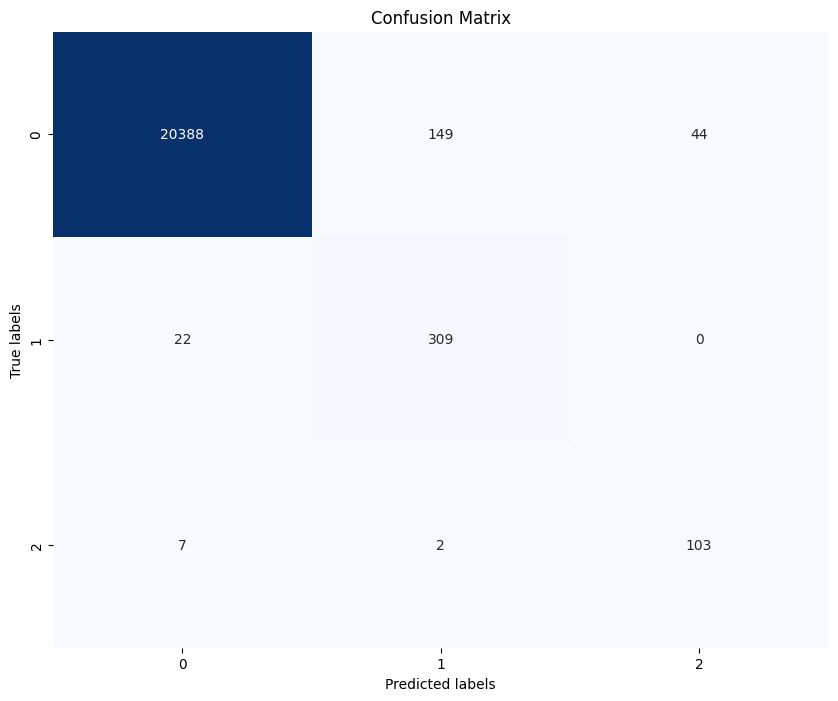

In [118]:
# Calculate confusion matrix
conf_matrix2 = confusion_matrix(y_test, y_pred_ann)

# Plot confusion matrix as heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix2, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

# <img src="./data/conclusion.png" alt="Conclusion Icon" width="30"/> **Conclusion**

<div style="background-color: rgba(144, 238, 144, 0.5); color: black; padding: 10px; border-radius: 5px;"> 
   
- Thorough **Exploratory Data Analysis (EDA)** is important in understanding the data and identifying relevant features contributing to our problem.

- In wind turbine fault detection (rare events), **Random Forest excels**. It prioritizes malfunctions/faults with high recall **(catches most)** and good precision **(avoids false alarms)**, making it the **best choice** for this **imbalanced multi classification** task.

- However, it is important to note none of the models achieve optimal results, some improvements need to be made to **fine-tune the model parameters** and **feature engineering** to better handle **imbalanced data** and **prioritize malfunction/fault** classification.

</div>

In [119]:
# Updated Macro scores for each classifier
classifiers = ["SVM", "Random Forest", "Gradient Boosting", "ANN"]
macro_precisions = [0.61, 0.90, 0.58, 0.79]  # Updated precision for ANN
macro_recalls = [0.90, 0.89, 0.95, 0.95]
macro_f1_scores = [0.69, 0.90, 0.67, 0.86]  # Updated F1-score for ANN
# Create traces
precision_trace = go.Bar(
    x=classifiers,
    y=macro_precisions,
    name='Macro Avg Precision',
    marker=dict(color='rgba(0, 102, 204, 0.8)')
)
recall_trace = go.Bar(
    x=classifiers,
    y=macro_recalls,
    name='Macro Avg Recall',
    marker=dict(color='rgba(0, 153, 51, 0.8)')
)
f1_trace = go.Bar(
    x=classifiers,
    y=macro_f1_scores,
    name='Macro Avg F1-score',
    marker=dict(color='rgba(255, 51, 51, 0.8)')
)
data = [precision_trace, recall_trace, f1_trace]
# Add values on top of bars
for trace in data:
    trace['text'] = [f'{score:.2f}' for score in trace.y]
    trace['textposition'] = 'auto'
# Layout
layout = go.Layout(
    title='Updated Evaluation Metrics Comparison for Each Classifier',
    xaxis=dict(title='Classifier'),
    yaxis=dict(title='Scores'),
    barmode='group'
)
fig = go.Figure(data=data, layout=layout)
fig.show()


![Chart4](./data/chart4.png)